<a href="https://colab.research.google.com/github/zitonghuangcynthia/CAIS-_Winter_Project/blob/main/ASL_database.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import torch

# If there's a GPU available...
if torch.cuda.is_available():
    # Tell PyTorch to use the GPU.
    device = torch.device("cuda")
    print('There are %d GPU(s) available.' % torch.cuda.device_count())
    print('We will use the GPU:', torch.cuda.get_device_name(0))

# If not...
else:
    print('No GPU available, using the CPU instead.')
    device = torch.device("cpu")

There are 1 GPU(s) available.
We will use the GPU: Tesla T4


In [2]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"zitongcynthiahuang","key":"6c43360da4f8b5864fa494a5c216c126"}'}

In [3]:
!pip install -q kaggle
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!ls ~/.kaggle
!chmod 600 /root/.kaggle/kaggle.json

kaggle.json


In [4]:
!kaggle datasets download -d grassknoted/asl-alphabet

 99% 1.02G/1.03G [00:10<00:00, 129MB/s]
100% 1.03G/1.03G [00:10<00:00, 102MB/s]


In [5]:
!pip install wget #use to download the dataset

  Preparing metadata (setup.py) ... done
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9655 sha256=fafaad046346f8eb4955b961709ee34aecf7636e870a2630536c41232d277fca
  Stored in directory: /root/.cache/pip/wheels/8b/f1/7f/5c94f0a7a505ca1c81cd1d9208ae2064675d97582078e6c769
Successfully built wget


In [ ]:
'''
import wget
import os

print('Downloading dataset...')
# The URL for the dataset zip file.
url = 'https://drive.google.com/file/d/1I_P_Sx0aKAxsZs7c0tO-PUtccyfttjcM/view?usp=drive_link'

# Download the file (if we haven't already)
if not os.path.exists('/content/ASLdataset.zip'):
    wget.download(url, '/content/ASLdataset.zip')
'''

In [6]:
# Unzip the dataset (if we haven't already)
import wget
import os
if not os.path.exists('/content/ASLdataset'):
    !unzip asl-alphabet.zip

流式输出内容被截断，只能显示最后 5000 行内容。
  inflating: asl_alphabet_train/asl_alphabet_train/nothing/nothing19.jpg  
  inflating: asl_alphabet_train/asl_alphabet_train/nothing/nothing190.jpg  
  inflating: asl_alphabet_train/asl_alphabet_train/nothing/nothing1900.jpg  
  inflating: asl_alphabet_train/asl_alphabet_train/nothing/nothing1901.jpg  
  inflating: asl_alphabet_train/asl_alphabet_train/nothing/nothing1902.jpg  
  inflating: asl_alphabet_train/asl_alphabet_train/nothing/nothing1903.jpg  
  inflating: asl_alphabet_train/asl_alphabet_train/nothing/nothing1904.jpg  
  inflating: asl_alphabet_train/asl_alphabet_train/nothing/nothing1905.jpg  
  inflating: asl_alphabet_train/asl_alphabet_train/nothing/nothing1906.jpg  
  inflating: asl_alphabet_train/asl_alphabet_train/nothing/nothing1907.jpg  
  inflating: asl_alphabet_train/asl_alphabet_train/nothing/nothing1908.jpg  
  inflating: asl_alphabet_train/asl_alphabet_train/nothing/nothing1909.jpg  
  inflating: asl_alphabet_train/asl_alphabet_train/n

In [95]:
import os
import matplotlib.pyplot as plt
import cv2

training_set = '/content/asl_alphabet_train/asl_alphabet_train'
testing_set = '/content/asl_alphabet_test/asl_alphabet_test'

#29 classes, A-Z and SPACE, DELETE and NOTHING.
labels = ['A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z', 'space', 'del', 'nothing']
num_classes = len(labels)
print("len of labels is", num_classes)
num_show = 5 #show 5 imgs for each class
fig, axs = plt.subplots(num_classes, num_show, figsize=(120, 120))

for i, label in enumerate(labels):
  label_path = os.path.join(training_set, label)
  image_files = os.listdir(label_path)[:num_show]

  for j, image in enumerate(image_files):
    image_path = os.path.join(label_path, image)
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    axs[i, j].imshow(img)
    axs[i, j].set_title(f"Category: {label}")
    axs[i, j].axis('off')

plt.tight_layout()
plt.show()


len of labels is 29


In [8]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#data preprocessing

In [106]:
import glob
import pandas as pd

path_list = []
label_list = []
test_original_path_list = []
test_original_label_list = []

for label in labels:
  label_path = os.path.join(training_set, label, "*") #to get all the files inside this specific file
  images_path = glob.glob(label_path) #find all the appropriate files for label_path


  for pth in images_path:
    path_list.append(pth)
    label_list.append(label)


testing_label_path = os.path.join(testing_set, "*")
testing_images_path = glob.glob(testing_label_path)


for pth in testing_images_path:
  test_original_path_list.append(pth)
  label = os.path.basename(pth).split('_')[0]
  test_original_label_list.append(label)



print(len(path_list))
print(len(label_list))
print(len(test_original_path_list))
print(len(test_original_label_list))
dataframe = pd.DataFrame(
    {
        "image_path": path_list,
        "label" : label_list
    }
)

test_origin_dataframe = pd.DataFrame(
    {
        "image_path": test_original_path_list,
        "label" : test_original_label_list
    }
)

#show dataframe
dataframe.head()
test_origin_dataframe.head()


87000
87000
28
28


,image_path,label
0,/content/asl_alphabet_test/asl_alphabet_test/H...,H
1,/content/asl_alphabet_test/asl_alphabet_test/E...,E
2,/content/asl_alphabet_test/asl_alphabet_test/Q...,Q
3,/content/asl_alphabet_test/asl_alphabet_test/V...,V
4,/content/asl_alphabet_test/asl_alphabet_test/M...,M


In [107]:
#use sklearn to split the dataset into train, validation and test
from sklearn.model_selection import train_test_split

df_shuffled = dataframe.sample(frac=1, random_state=42).reset_index(drop=True)
df_shuffled.head()

train_ratio = 0.7
valid_test_ratio = 0.15

train_df, valid_test_df = train_test_split(df_shuffled, test_size=(1 - train_ratio), random_state=42)
valid_df, test_df = train_test_split(valid_test_df, test_size=valid_test_ratio / (valid_test_ratio + valid_test_ratio), random_state=42)

print(len(train_df), len(valid_test_df), len(test_df))
display(train_df)
display(valid_df)
display(test_df)

60899 26101 13051


,image_path,label
46016,/content/asl_alphabet_train/asl_alphabet_train...,E
81540,/content/asl_alphabet_train/asl_alphabet_train...,J
72023,/content/asl_alphabet_train/asl_alphabet_train...,D
22928,/content/asl_alphabet_train/asl_alphabet_train...,space
54367,/content/asl_alphabet_train/asl_alphabet_train...,del
...,...,...
6265,/content/asl_alphabet_train/asl_alphabet_train...,C
54886,/content/asl_alphabet_train/asl_alphabet_train...,G
76820,/content/asl_alphabet_train/asl_alphabet_train...,Q
860,/content/asl_alphabet_train/asl_alphabet_train...,T


,image_path,label
15618,/content/asl_alphabet_train/asl_alphabet_train...,C
7953,/content/asl_alphabet_train/asl_alphabet_train...,nothing
27550,/content/asl_alphabet_train/asl_alphabet_train...,N
64052,/content/asl_alphabet_train/asl_alphabet_train...,W
73789,/content/asl_alphabet_train/asl_alphabet_train...,B
...,...,...
57936,/content/asl_alphabet_train/asl_alphabet_train...,L
35907,/content/asl_alphabet_train/asl_alphabet_train...,F
59565,/content/asl_alphabet_train/asl_alphabet_train...,J
33830,/content/asl_alphabet_train/asl_alphabet_train...,B


,image_path,label
37831,/content/asl_alphabet_train/asl_alphabet_train...,T
11827,/content/asl_alphabet_train/asl_alphabet_train...,H
41915,/content/asl_alphabet_train/asl_alphabet_train...,M
66468,/content/asl_alphabet_train/asl_alphabet_train...,L
9069,/content/asl_alphabet_train/asl_alphabet_train...,I
...,...,...
39315,/content/asl_alphabet_train/asl_alphabet_train...,W
81013,/content/asl_alphabet_train/asl_alphabet_train...,D
3859,/content/asl_alphabet_train/asl_alphabet_train...,Y
59158,/content/asl_alphabet_train/asl_alphabet_train...,del


In [109]:
#normalize the data
import torch
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
from PIL import Image

class CustomDataset(Dataset):
  def __init__(self, dataframe, transform=None):
    self.data = dataframe
    self.transform = transform
  def __len__(self):
    return len(self.data)
  def __getitem__(self, idx):
    img_path = self.data.iloc[idx, 0]
    img = Image.open(img_path).convert('RGB')
    label = self.data.iloc[idx, 1]

    if self.transform != None:
      image = self.transform(img)

    return image, label


transformation = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

train_dataset = CustomDataset(train_df, transformation)
valid_dataset = CustomDataset(valid_df, transformation)
test_dataset = CustomDataset(test_df, transformation)
test_original_dataset = CustomDataset(test_origin_dataframe, transformation)
test_dataset_combine = test_dataset + test_original_dataset

#create dataloader
train_loader = DataLoader(train_dataset, batch_size = 32, shuffle = True)
valid_loader = DataLoader(valid_dataset, batch_size = 32, shuffle = True)
test_loader = DataLoader(test_dataset_combine, batch_size = 32, shuffle = True)

print(train_dataset)
print(len(test_dataset_combine))


13079


('del', 'U', 'E', 'E', 'F', 'A', 'E', 'Q', 'P', 'space', 'S', 'P', 'O', 'nothing', 'O', 'U', 'space', 'U', 'U', 'J', 'L', 'U', 'V', 'O', 'Y', 'J', 'X', 'W', 'nothing', 'space', 'T', 'J')


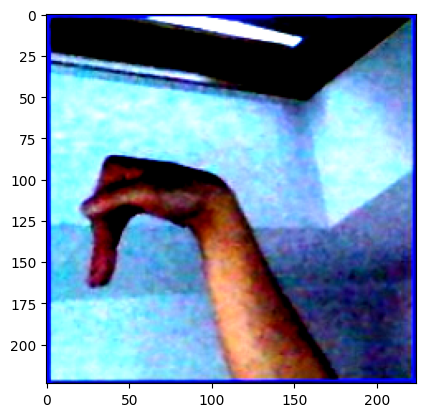

409


In [115]:
#check our testing set and loader
for i, (img, label) in enumerate(test_loader):
    #print(img[0].size(), label[0])
    img_np = img[0].permute(1, 2, 0).numpy()  # Convert to NumPy and rearrange dimensions
    #print(img_np)
    print(label)

    plt.imshow(img_np)  # Display the image using matplotlib.pyplot
    plt.show()
    break

print(len(test_loader))

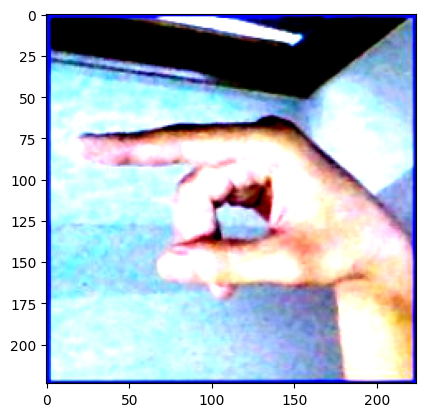

1904


In [76]:
#check our traning set and loader
for i, (img, label) in enumerate(train_loader):
    #print(img[0].size(), label[0])
    img_np = img[0].permute(1, 2, 0).numpy()  # Convert to NumPy and rearrange dimensions
    #print(img_np)

    plt.imshow(img_np)  # Display the image using matplotlib.pyplot
    plt.show()
    break

print(len(train_loader))

[[[-2.117904   -2.0007002   2.622571  ]
  [-2.117904   -2.0182073   2.5702832 ]
  [-2.0494049  -2.0007002   2.465708  ]
  ...
  [-2.0665298  -2.0357141   2.4482791 ]
  [-2.1007793  -2.0357141   2.4482791 ]
  [-2.1007793  -1.9831933   2.4831376 ]]

 [[-2.117904   -2.0182073   2.5702832 ]
  [-2.1007793  -2.0007002   2.3611329 ]
  [-2.0494049  -1.9831933   1.9602616 ]
  ...
  [-1.9295317  -1.9831933   1.7685405 ]
  [-1.9637812  -1.9306722   2.0125492 ]
  [-2.0836544  -2.0182073   2.0474076 ]]

 [[-2.0665298  -2.0357141   2.4482791 ]
  [-2.0322802  -1.9656862   1.9602616 ]
  [-1.0219197  -0.897759    2.0125492 ]
  ...
  [-0.81642264 -0.9502801   1.3153814 ]
  [-1.1075436  -1.177871    1.733682  ]
  [-1.8610327  -1.8956583   1.367669  ]]

 ...

 [[-2.0836544  -1.9831933   2.465708  ]
  [-2.0322802  -1.9306722   1.8033988 ]
  [-1.7240347  -1.6505601   0.7227889 ]
  ...
  [ 0.3651854   0.3802522   1.5942485 ]
  [-0.08005828 -0.00490195  2.0822659 ]
  [-1.8781574  -1.8081232   0.77507645]]

 [

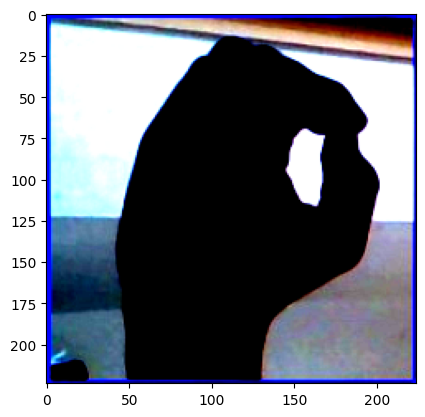

In [50]:
#check our validation set and loader
for i, (img, label) in enumerate(valid_loader):
    #print(img[0].size(), label[0])
    img_np = img[0].permute(1, 2, 0).numpy()  # Convert to NumPy and rearrange dimensions
    print(img_np)

    plt.imshow(img_np)  # Display the image using matplotlib.pyplot
    plt.show()
    break

In [87]:
#prepare for traning, download the pretrain model
from torchvision import models, transforms, datasets
resnet_model = models.resnet50(pretrained=True)

In [88]:
#freeze other parameters, avoid being changed
for params in resnet_model.parameters():
  params.requires_grad = False

from torch import nn
last_in_feature = resnet_model.fc.in_features
fully_connected = nn.Linear(in_features=last_in_feature, out_features=num_classes)
resnet_model.fc = fully_connected

resnet_model

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [89]:
param_update = []
for param in resnet_model.parameters():
  if param.requires_grad == True:
    param_update.append(param)

loss_function = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(param_update, lr=0.001)

In [90]:
#define the train function
def train(model, loss_function, optimizer, train_loader, val_loader, num_epoch):
  train_loss = []
  validation_loss = []
  model.to(device)
  num_trained = 0
  label_mapping = {'A': 0, 'B': 1, 'C': 2, 'D': 3, 'E': 4, 'F': 5, 'G': 6, 'H': 7, 'I': 8, 'J': 9, 'K': 10, 'L': 11, 'M': 12, 'N': 13, 'O': 14, 'P': 15, 'Q': 16, 'R': 17, 'S': 18, 'T': 19, 'U': 20, 'V': 21, 'W': 22, 'X': 23, 'Y': 24, 'Z': 25, 'space': 26, 'del': 27, 'nothing': 28}

  for epoch in range(num_epoch):
    running_loss = 0
    total_train = 0
    model.train()
    for image, label in train_loader:
      num_trained += 1
      image = image.to(device)
      label = [label_mapping[char] for char in label]
      label = torch.tensor(label)
      label = label.to(device)
      prediction = model(image)
      loss = loss_function(prediction, label)

      optimizer.zero_grad()
      loss.backward()
      optimizer.step()

      running_loss += loss.item()

      #print out the process, every 200 steps
      if num_trained % 200 == 0:
        print(f'Epoch is {epoch}  {num_trained}/{len(train_loader)}, average train loss is {running_loss/num_trained}', end='   ')
        #See the validation set
        with torch.no_grad():
          model.eval()
          valid_loss = 0
          valid_num = 0
          for valid_image, valid_label in valid_loader:
            #print(type(valid_image))
            #print(valid_image)
            valid_image = valid_image.to(device)
            valid_label = [label_mapping[char] for char in valid_label]
            valid_label = torch.tensor(valid_label)
            valid_label = valid_label.to(device)
            valid_label = valid_label.view(-1)
            #print(valid_label.shape)
            valid_prediction = model(valid_image)
            #print(valid_prediction.shape)
            loss = loss_function(valid_prediction, valid_label)
            valid_loss += loss
            valid_num += valid_label.size(0)
        print(f'average validation loss is {valid_loss/len(valid_loader)}')

        train_loss.append(running_loss)
        validation_loss.append(valid_loss)


    torch.save(model, f'checkpoint_{epoch}_{num_trained}')

    return model, train_loss, validation_loss

In [91]:
#train
num_epoch = 1
resnet_model, train_loss, validation_loss = train(model=resnet_model, loss_function = loss_function, optimizer = optimizer, train_loader = train_loader, val_loader = valid_loader, num_epoch = num_epoch)

Epoch is 0  200/1904, average train loss is 2.1358981847763063   average validation loss is 1.2304062843322754
Epoch is 0  400/1904, average train loss is 1.561182557940483   average validation loss is 0.8178760409355164
Epoch is 0  600/1904, average train loss is 1.272537473489841   average validation loss is 0.6179390549659729
Epoch is 0  800/1904, average train loss is 1.097095847055316   average validation loss is 0.5118553638458252
Epoch is 0  1000/1904, average train loss is 0.9690388579070568   average validation loss is 0.43444085121154785
Epoch is 0  1200/1904, average train loss is 0.8766383605947097   average validation loss is 0.4025013744831085
Epoch is 0  1400/1904, average train loss is 0.8022661743951696   average validation loss is 0.34894105792045593
Epoch is 0  1600/1904, average train loss is 0.7428487888444215   average validation loss is 0.3297579288482666
Epoch is 0  1800/1904, average train loss is 0.6938981369572381   average validation loss is 0.28901606798171

In [132]:
#evaluation: using test dataloader
from sklearn.metrics import f1_score

label_mapping = {'A': 0, 'B': 1, 'C': 2, 'D': 3, 'E': 4, 'F': 5, 'G': 6, 'H': 7, 'I': 8, 'J': 9, 'K': 10, 'L': 11, 'M': 12, 'N': 13, 'O': 14, 'P': 15, 'Q': 16, 'R': 17, 'S': 18, 'T': 19, 'U': 20, 'V': 21, 'W': 22, 'X': 23, 'Y': 24, 'Z': 25, 'space': 26, 'del': 27, 'nothing': 28}
correct_num = 0
total_num = 0
accuracy_list = []
f1_list_micro = []
f1_list_macro = []

for i, (image, label) in enumerate(test_loader):
  image = image.to(device)
  #print(image.shape)
  label = [label_mapping[char] for char in label]
  label = torch.tensor(label)
  label = label.to(device)
  #print(f'label is {label}')
  total_num += label.shape[0]
  resnet_model.eval()

  with torch.no_grad():
    prediction = resnet_model(image)

    # Access the predicted class index or probability distribution as needed
    _, predictions = torch.max(prediction, 1)
    #prediction = torch.argmax(prediction).item()
    #print(f'prediction is {predictions}')
    correct_num += (predictions == label).sum().item()



  accuracy = (correct_num / total_num) * 100 #TODO: calculate accuracy
  accuracy_list.append(accuracy)
  predictions = predictions.cpu().numpy()
  label = label.cpu().numpy()
  single_f1_micro = f1_score(label, predictions, average='micro')
  f1_list_micro.append(single_f1_micro)
  single_f1_macro = f1_score(label, predictions, average='macro')
  f1_list_macro.append(single_f1_macro)


print(f'Average Accuracy: {sum(accuracy_list)/len(accuracy_list)}')
print(f'Average micro f1 score: {sum(f1_list_micro)/len(f1_list_micro)}')
print(f'Average macro f1 score: {sum(f1_list_macro)/len(f1_list_macro)}')


Average Accuracy: 92.61511961584317
Average micro f1 score: 0.9286369193154034
Average macro f1 score: 0.8910498969748554


Next, let's visualize some images, as well as their respective labels.